In [ ]:
#空间杜宾模型
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from libpysal.weights import KNN, DistanceBand
from spreg import GM_Lag

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 确保坐标列为数值类型
df['X2'] = pd.to_numeric(df['X2'], errors='coerce')
df['Y'] = pd.to_numeric(df['Y'], errors='coerce')

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 创建空间权重矩阵（基于K最近邻方法，尝试不同的k值）
knn = KNN.from_array(coords, k=8)  # 尝试将k值增加到8

# 如果KNN仍然不收敛，可以尝试使用DistanceBand创建基于距离的空间权重矩阵
# dist_band = DistanceBand.from_array(coords, threshold=1000)  # 根据实际情况调整阈值

# 应用空间杜宾模型（GM Lag Model）
try:
    model = GM_Lag(y.flatten(), X_scaled, w=knn, name_y=y_column, name_x=X_columns, spat_diag=True)
    print(model.summary)
except Exception as e:
    print(f"An error occurred: {e}")
    # 如果KNN仍不收敛，可以尝试使用DistanceBand
    dist_band = DistanceBand.from_array(coords, threshold=1000)  # 根据实际情况调整阈值
    try:
        model = GM_Lag(y.flatten(), X_scaled, w=dist_band, name_y=y_column, name_x=X_columns, spat_diag=True)
        print(model.summary)
    except Exception as e:
        print(f"An error occurred with DistanceBand: {e}")

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# 示例数据：假设这是从模型中提取的系数信息
# 请注意，你需要替换这些数据为你实际从模型中获取的数据
model_betas = np.array([0.02527, 0.13318, -0.10984, 0.15230, 0.35304, 0.17410, 0.17086, -2.15862, 1.60070,
                        0.78737, -0.05164, -0.10796, -0.34833, 0.25877, -0.29270, -0.19395, 0.06227, 0.01960,
                        -0.27055, -0.14103, -0.08613, 0.22291, 0.42425, -0.28819, 0.33935, 0.17025, -0.17783,
                        -0.96435, 0.16394, 0.00357, 0.09974, 0.46659, 0.01520, 0.01284, 0.17577, 0.07674, 0.04436])
variable_names = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                  'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                  'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                  'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                  'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']
variable_names = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                  'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                  'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                  'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                  'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF',
    'beijing_SY_midu': 'DCF',
    'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI',
    'road_density': 'RD',
    'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM',
    'floor_area_ratio': 'FAR',
    'p_cd': 'GF',
    'p_gyyd': 'PGF',
    'p_gggl': 'AF',
    'p_gc': 'SF',
    'p_jt': 'TSF',
    'p_ld': 'BLF',
    'p_nd': 'CF',
    'p_sl': 'FF',
    'p_sy': 'CSF',
    'p_sd': 'WF',
    'p_st': 'WBF',
    'p_zzyd': 'RF',
    'landuse_hhd': 'MULT',
    'ndvi': 'NDVI',
    'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS',
    'wendu': 'AMT',
    'build_buguize': 'BBI',
    'avg_height': 'MBH',
    'shape_coefficient_sum': 'BSC',
    'jiaochakou': 'NRD',
    'shape_index': 'MSI',
    'TotalDensity': 'ED',
    'mean_SVF': 'SVF',
    'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax',
    'mean_kuai': 'PD',
    'dengguang': 'NLD',
    'ydl':'EC'
}

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': model_betas
})

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=100)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.01 if coef['Coefficient'] >= 0 else -0.01 # 调整标签位置使其不与条形图重叠
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# 示例数据：假设这是从模型中提取的系数信息
model_betas = np.array([0.02527, 0.13318, -0.10984, 0.15230, 0.35304, 0.17410, 0.17086, -2.15862, 1.60070,
                        0.78737, -0.05164, -0.10796, -0.34833, 0.25877, -0.29270, -0.19395, 0.06227, 0.01960,
                        -0.27055, -0.14103, -0.08613, 0.22291, 0.42425, -0.28819, 0.33935, 0.17025, -0.17783,
                        -0.96435, 0.16394, 0.00357, 0.09974, 0.46659, 0.01520, 0.01284, 0.17577, 0.07674, 0.04436])
variable_names = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                  'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                  'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                  'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                  'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF',
    'beijing_SY_midu': 'DCF',
    'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI',
    'road_density': 'RD',
    'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM',
    'floor_area_ratio': 'FAR',
    'p_cd': 'GF',
    'p_gyyd': 'PGF',
    'p_gggl': 'AF',
    'p_gc': 'SF',
    'p_jt': 'TSF',
    'p_ld': 'BLF',
    'p_nd': 'CF',
    'p_sl': 'FF',
    'p_sy': 'CSF',
    'p_sd': 'WF',
    'p_st': 'WBF',
    'p_zzyd': 'RF',
    'landuse_hhd': 'MULT',
    'ndvi': 'NDVI',
    'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS',
    'wendu': 'AMT',
    'build_buguize': 'BBI',
    'avg_height': 'MBH',
    'shape_coefficient_sum': 'BSC',
    'jiaochakou': 'NRD',
    'shape_index': 'MSI',
    'TotalDensity': 'ED',
    'mean_SVF': 'SVF',
    'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax',
    'mean_kuai': 'PD',
    'dengguang': 'NLD',
    'ydl':'EC'
}

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': model_betas
})

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签
    ax.text(abs(coef['Coefficient']) + 0.01, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

In [ ]:
#空间滞后模型
import pandas as pd
import numpy as np
from libpysal.weights import DistanceBand, W
from spreg import ML_Lag  # 使用 ML_Lag 进行最大似然估计的空间滞后模型
from sklearn.preprocessing import StandardScaler

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 确保坐标列为数值类型
df['X2'] = pd.to_numeric(df['X2'], errors='coerce')
df['Y'] = pd.to_numeric(df['Y'], errors='coerce')

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 创建并标准化空间权重矩阵
w_db = DistanceBand.from_array(np.array(coords), threshold=500, binary=False)  # 尝试减小阈值
w_db.transform = 'r'  # 标准化权重矩阵，使每行的权重之和为1

# 拟合空间滞后模型
try:
    slm = ML_Lag(y.flatten(), X_scaled, w_db, name_y=y_column, name_x=X_columns)
    print(slm.summary)
except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# 示例数据
data = {
    'Variable': ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                 'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                 'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                 'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                 'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio'],
    'Coefficient': [0.02465, 0.07032, -0.09249, 0.13018, 0.27439, 0.14294, 0.09384, -1.23726, 0.83960, 0.52504,
                    -0.03765, -0.08384, -0.26813, 0.12885, -0.12597, -0.12773, 0.05267, 0.00528, -0.17133, -0.08819,
                    -0.03820, 0.19755, 0.38545, -0.21475, 0.32898, 0.14418, -0.07977, -0.58547, 0.14072, 0.00721,
                    0.11575, 0.43257, 0.01403, 0.04517, 0.09261, 0.03494, 0.05526]
}

# 创建DataFrame
coefficients_df = pd.DataFrame(data)

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm

# 示例数据
data = {
    'Variable': ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                 'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                 'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                 'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                 'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio'],
    'Coefficient': [0.02465, 0.07032, -0.09249, 0.13018, 0.27439, 0.14294, 0.09384, -1.23726, 0.83960, 0.52504,
                    -0.03765, -0.08384, -0.26813, 0.12885, -0.12597, -0.12773, 0.05267, 0.00528, -0.17133, -0.08819,
                    -0.03820, 0.19755, 0.38545, -0.21475, 0.32898, 0.14418, -0.07977, -0.58547, 0.14072, 0.00721,
                    0.11575, 0.43257, 0.01403, 0.04517, 0.09261, 0.03494, 0.05526]
}

# 创建DataFrame
coefficients_df = pd.DataFrame(data)

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
    'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
    'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
    'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
    'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
    'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
}

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签
    ax.text(abs(coef['Coefficient']) + 0.01, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

In [ ]:
#空间滞后模型  SLM
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import libpysal as lps
from spreg.ml_lag import ML_Lag
import matplotlib.pyplot as plt

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 确保坐标列为数值类型
df['X2'] = pd.to_numeric(df['X2'], errors='coerce')
df['Y'] = pd.to_numeric(df['Y'], errors='coerce')

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 对自变量进行标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 创建空间权重矩阵
w = lps.weights.KNN.from_array(coords, k=4)  # 使用KNN方法，k=4表示每个点的最近4个邻居
w.transform = 'r'  # 标准化权重矩阵

# 添加常数项到标准化后的自变量
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间杜宾模型
try:
    model = ML_Lag(y.flatten(), X_scaled_with_const, w=w, name_y=y_column, name_x=['CONSTANT'] + X_columns)
    print("Regression Summary:")
    print(model.summary)
    
    # 提取系数
    betas = model.betas.flatten()
    variable_names = ['CONSTANT'] + X_columns + [f"W_{y_column}"]
    
    # 构建DataFrame
    coefficients_df = pd.DataFrame({
        'Variable': variable_names,
        'Coefficient': betas
    })
    
    # 去掉 CONSTANT 和 W_value_x 列
    coefficients_df = coefficients_df[~coefficients_df['Variable'].isin(['CONSTANT', f"W_{y_column}"])]
    
    # 根据系数的绝对值进行排序
    coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)
    
    # 设置绘图参数
    fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)
    
    # 分别绘制正系数和负系数
    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = 'red' if coef['Coefficient'] >= 0 else 'green'
        text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
        text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
        
        # 绘制条形图
        ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
        
        # 添加数值标签
        ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
                va='center', ha=text_alignment, fontsize=8)
    
    # 调整y轴刻度和标签
    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Variable'])
    
    # 添加分割线帮助区分正负影响
    ax.axvline(x=0, color='grey', linestyle='--')
    
    ax.set_xlabel('Coefficient Values')
    ax.set_title('Sorted Coefficients by Feature Impact')
    
    # 图例
    from matplotlib.patches import Patch
    legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                       Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
    ax.legend(handles=legend_elements)
    
    plt.tight_layout()
    plt.show()

except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
#ols模型
import pandas as pd
import numpy as np
from pysal.lib import weights
from pysal.model.spreg import OLS as sp_Ols
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 添加常数项到标准化后的自变量
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 运行普通最小二乘回归作为比较基准
ols = sp_Ols(y=y, x=X_scaled_with_const, name_y=y_column, name_x=['CONSTANT'] + X_columns)

# 输出模型结果
print("OLS Results:\n", ols.summary)

# 提取系数
betas = ols.betas.flatten()
variable_names = ['CONSTANT'] + X_columns

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': betas
})

# 去掉 CONSTANT 列
coefficients_df = coefficients_df[coefficients_df['Variable'] != 'CONSTANT']

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
from pysal.lib import weights
from pysal.model.spreg import OLS as sp_Ols
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from matplotlib import cm

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 添加常数项到标准化后的自变量
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 运行普通最小二乘回归作为比较基准
ols = sp_Ols(y=y, x=X_scaled_with_const, name_y=y_column, name_x=['CONSTANT'] + X_columns)

# 输出模型结果
print("OLS Results:\n", ols.summary)

# 提取系数
betas = ols.betas.flatten()
variable_names = ['CONSTANT'] + X_columns

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': betas
})

# 去掉 CONSTANT 列
coefficients_df = coefficients_df[coefficients_df['Variable'] != 'CONSTANT']

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
    'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
    'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
    'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
    'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
    'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
}

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签，保留两位小数
    ax.text(abs(coef['Coefficient']) + 0.01, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

In [ ]:
#正确的SEM基于空间误差模型（Spatial Error Model, SEM）广义矩估计
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from pysal.lib import weights
from pysal.model.spreg import GM_Error
import matplotlib.pyplot as plt

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 更新变量名列表以包含常数项
name_x_with_const = ['CONSTANT'] + X_columns

# 使用GM_Error进行回归，并提供变量名
sem_gmm = GM_Error(y=y, x=X_scaled_with_const, w=w, name_y=y_column, name_x=name_x_with_const)
print("GM_Error Results:\n", sem_gmm.summary)

# 提取GM_Error模型的系数
betas = sem_gmm.betas.flatten()

# 获取有效的变量名（去除可能被自动移除的常数项）
effective_variable_names = [name for name in name_x_with_const if name != 'CONSTANT']

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': effective_variable_names,
    'Coefficient': betas[1:len(effective_variable_names)+1]  # 跳过 CONSTANT
})

# 过滤掉 CONSTANT 和 lambda (如果存在)
coefficients_df = coefficients_df[~coefficients_df['Variable'].isin(['lambda'])]

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=100)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact (GM_Error Model)')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from pysal.lib import weights
from pysal.model.spreg import GM_Error
import matplotlib.pyplot as plt
from matplotlib import cm

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 更新变量名列表以包含常数项
name_x_with_const = ['CONSTANT'] + X_columns

# 使用GM_Error进行回归，并提供变量名
sem_gmm = GM_Error(y=y, x=X_scaled_with_const, w=w, name_y=y_column, name_x=name_x_with_const)
print("GM_Error Results:\n", sem_gmm.summary)

# 提取GM_Error模型的系数
betas = sem_gmm.betas.flatten()

# 获取有效的变量名（去除可能被自动移除的常数项）
effective_variable_names = [name for name in name_x_with_const if name != 'CONSTANT']
if 'lambda' in sem_gmm.name_x:
    effective_variable_names += ['lambda']

# 构建DataFrame，但首先过滤掉 CONSTANT 和 lambda
coefficients_df = pd.DataFrame({
    'Variable': [var for var in effective_variable_names if var not in ['CONSTANT', 'lambda']],
    'Coefficient': betas[1:-1] if 'lambda' in sem_gmm.name_x else betas[1:]
})

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
    'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
    'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
    'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
    'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
    'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
}

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 数值标签与条形图的距离
text_x_offset = 0.00  # 可以根据实际需要调整此值

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签，保留两位小数
    ax.text(abs(coef['Coefficient']) + text_x_offset, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact (GM_Error Model)')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

In [ ]:
#gwr模型对比
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import warnings  # 导入warnings模块

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 将标准化后的数据转换回DataFrame以保留列名
X_scaled_df = pd.DataFrame(X_scaled, columns=X_columns)

# 检查是否有缺失值并处理
if np.any(np.isnan(X_scaled_df)) or np.any(np.isnan(y)):
    print("Warning: There are NaN values in the data.")
    # 删除含有NaN值的行
    mask = ~np.isnan(y.flatten())
    y = y[mask]
    X_scaled_df = X_scaled_df[mask].reset_index(drop=True)  # 重置索引以确保连续性
    coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()
    
    # 获取每个特征的平均回归系数
    coef_means = np.mean(gwr_model.params, axis=0)[1:]  # 忽略截距项
    
    # 分离正负系数并创建DataFrame
    coefficients = pd.DataFrame({
        'Feature': X_columns,
        'Coefficient': coef_means
    })
    # 输出结果摘要
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    
    # 注意：根据mgwr版本，可能需要调整这些属性名称
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")  # 修正了这里的语法错误
    
    print("\nAverage Coefficients:")
    print(coefficients)
    
except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")

In [56]:
import pandas as pd
import matplotlib.pyplot as plt

# 假设coefficients DataFrame已经在之前的代码中定义并填充了数据

# 打印coefficients DataFrame的前几行，以确认其内容
print("Coefficients DataFrame:")
print(coefficients.head())

# 确认coefficients包含'Feature'和'Coefficient'两列
if 'Feature' not in coefficients.columns or 'Coefficient' not in coefficients.columns:
    raise ValueError("Coefficients DataFrame must contain 'Feature' and 'Coefficient' columns.")

# 计算绝对值并根据绝对值大小升序排列
coefficients['Abs_Coefficient'] = abs(coefficients['Coefficient'])
coefficients_sorted = coefficients.sort_values(by='Abs_Coefficient', ascending=True)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(12, 10), dpi=1000)
font = {'family': 'Times New Roman'}
plt.rc('font', **font)

# 绘制条形图，并根据系数的正负决定文本标签的位置
for idx, (feature, coef) in enumerate(zip(coefficients_sorted.index, coefficients_sorted['Coefficient']), start=1):
    if coef >= 0:
        color = 'red'
        text_alignment = 'left'
        text_x_offset = 0.02
    else:
        color = 'green'
        text_alignment = 'right'
        text_x_offset = -0.02
    
    # 绘制条形图
    ax.barh(idx, coef, color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef + text_x_offset, idx, f"{coef:.4f}", va='center', ha=text_alignment, fontsize=8, fontdict=font)

# 设置y轴标签
ax.set_yticks(range(1, len(coefficients_sorted)+1))
ax.set_yticklabels(coefficients_sorted['Feature'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values', fontdict=font)
ax.set_title('GWR Coefficients by Feature (Positive vs Negative Impact)', fontdict=font)

# 图例
ax.legend(['Negative Impact', 'Positive Impact'], prop={'family': 'Times New Roman'})

plt.tight_layout()
plt.show()

Coefficients DataFrame:
                 Feature  Coefficient
0          build_buguize    -0.029370
1             avg_height     0.126709
2  shape_coefficient_sum    -0.082511
3             jiaochakou     0.169567
4              mean_kuai     0.231411


In [1]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings  # 导入warnings模块

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 将标准化后的数据转换回DataFrame以保留列名
X_scaled_df = pd.DataFrame(X_scaled, columns=X_columns)

# 检查是否有缺失值并处理
if np.any(np.isnan(X_scaled_df)) or np.any(np.isnan(y)):
    print("Warning: There are NaN values in the data.")
    # 删除含有NaN值的行
    mask = ~np.isnan(y.flatten())
    y = y[mask]
    X_scaled_df = X_scaled_df[mask].reset_index(drop=True)  # 重置索引以确保连续性
    coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()
    
    # 获取每个特征的平均回归系数
    coef_means = np.mean(gwr_model.params, axis=0)[1:]  # 忽略截距项
    
    # 分离正负系数并创建DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]
    
    # 输出结果摘要
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")  # 修正了这里的语法错误
    
    print("\nAverage Coefficients:")
    print(coefficients)
    
    # 根据系数的绝对值进行排序
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)
    
    # 设置绘图参数
    fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman', 'size': 12}
    plt.rc('font', **font)

    # 获取指定位置颜色
    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    # 数值标签与条形图的距离
    text_x_offset = 0.00  # 可以根据实际需要调整此值

    # 分别绘制正系数和负系数
    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        
        # 绘制条形图
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
        
        # 添加数值标签，保留两位小数
        ax.text(abs(coef['Coefficient']) + text_x_offset, idx, f"{coef['Coefficient']:.2f}", 
                va='center', ha='left', fontsize=14, fontdict=font)

    # 调整y轴刻度和标签
    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=14)
    # 设置x轴标签字体大小
    ax.set_xlabel('Coefficient Values', fontsize=14, fontdict=font)  # 如果需要更大，可以调整这里的14值
    ax.set_title('Sorted Coefficients by Feature Impact (GWR Model)', fontsize=16, fontdict=font)  # 调整标题字体大小
    # 添加分割线帮助区分正负影响
    ax.axvline(x=0, color='grey', linestyle='--')
    
    # 减少上下空白
    plt.subplots_adjust(top=0.95, bottom=0.25)

    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 441.0
Residual standard error: 1.5274
Multiple R-squared: 0.8411
Adjusted R-squared: 0.8340
AIC: 9466.6666
BIC: 10099.3377

Average Coefficients:
    Feature  Coefficient
0       BBI    -0.029370
1       MBH     0.126709
2       BSC    -0.082511
3       NRD     0.169567
4        PD     0.231411
5       MSI     0.139999
6        ED    -0.058161
7      ASWR    -1.964962
8       AAS     1.446401
9       AMT     0.479768
10      GDP     0.011368
11      NLD    -0.012963
12     NDVI    -0.298390
13      SVF     0.116524
14  AMMTmax    -0.181239
15       EC    -0.025563
16      DGF     0.027958
17      DCF     0.033879
18      PLD    -0.154863
19     MUOI    -0.098601
20       GF     0.114484
21      PGF     0.187090
22       AF     0.340836
23       SF    -0.572469
24      TSF     0.277025
25      BLF     0.206385
26       CF    -0.112860
27       FF    -0.699411
28      CSF     0.135519
29       WF     0.005832
30      WBF     0.076749
31       RF     

TypeError: Got both 'size' and 'fontsize', which are aliases of one another

In [2]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 将标准化后的数据转换回DataFrame以保留列名
X_scaled_df = pd.DataFrame(X_scaled, columns=X_columns)

# 检查是否有缺失值并处理
if np.any(np.isnan(X_scaled_df)) or np.any(np.isnan(y)):
    print("Warning: There are NaN values in the data.")
    # 删除含有NaN值的行
    mask = ~np.isnan(y.flatten())
    y = y[mask]
    X_scaled_df = X_scaled_df[mask].reset_index(drop=True)  # 重置索引以确保连续性
    coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取每个特征的平均回归系数
    coef_means = np.mean(gwr_model.params, axis=0)[1:]  # 忽略截距项

    # 分离正负系数并创建DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]

    # 输出结果摘要
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")  # 修正了这里的语法错误

    print("\nAverage Coefficients:")
    print(coefficients)

    # 根据系数的绝对值进行排序
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)

    # 设置绘图参数
    fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman', 'size': 12}
    plt.rc('font', **font)

    # 获取指定位置颜色
    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    # 数值标签与条形图的距离
    text_x_offset = 0.00  # 可以根据实际需要调整此值

    # 分别绘制正系数和负系数
    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        
        # 绘制条形图
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
        
        # 添加数值标签，保留两位小数
        ax.text(abs(coef['Coefficient']) + text_x_offset, idx, f"{coef['Coefficient']:.2f}", 
                va='center', ha='left', fontsize=14)

    # 调整y轴刻度和标签
    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=14)
    
    # 设置x轴标签字体大小
    ax.set_xlabel('Coefficient Values', fontsize=14)  # 如果需要更大，可以调整这里的14值
    ax.set_title('Sorted Coefficients by Feature Impact (GWR Model)', fontsize=16)  # 调整标题字体大小
    
    # 设置x轴刻度标签字体大小
    for label in ax.get_xticklabels():
        label.set_fontsize(12)  # 根据需要调整大小

    # 添加分割线帮助区分正负影响
    ax.axvline(x=0, color='grey', linestyle='--')

    # 减少上下空白
    plt.subplots_adjust(top=0.95, bottom=0.25)

    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 441.0
Residual standard error: 1.5274
Multiple R-squared: 0.8411
Adjusted R-squared: 0.8340
AIC: 9466.6666
BIC: 10099.3377

Average Coefficients:
    Feature  Coefficient
0       BBI    -0.029370
1       MBH     0.126709
2       BSC    -0.082511
3       NRD     0.169567
4        PD     0.231411
5       MSI     0.139999
6        ED    -0.058161
7      ASWR    -1.964962
8       AAS     1.446401
9       AMT     0.479768
10      GDP     0.011368
11      NLD    -0.012963
12     NDVI    -0.298390
13      SVF     0.116524
14  AMMTmax    -0.181239
15       EC    -0.025563
16      DGF     0.027958
17      DCF     0.033879
18      PLD    -0.154863
19     MUOI    -0.098601
20       GF     0.114484
21      PGF     0.187090
22       AF     0.340836
23       SF    -0.572469
24      TSF     0.277025
25      BLF     0.206385
26       CF    -0.112860
27       FF    -0.699411
28      CSF     0.135519
29       WF     0.005832
30      WBF     0.076749
31       RF     

In [8]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数并转换为DataFrame
    coef_means = np.mean(gwr_model.params, axis=0)[1:]
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nAverage Coefficients:")
    print(coefficients)

    # 根据绝对值排序系数
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)

    # 绘制条形图
    fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman', 'size': 12}
    plt.rc('font', **font)

    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.85)
        ax.text(abs(coef['Coefficient']) + 0.005, idx, f"{coef['Coefficient']:.2f}", va='center', ha='left', fontsize=20)

    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=20)#修改字体大小
    ax.set_xlabel('Coefficient Values', fontsize=20)
    ax.set_title('', fontsize=20)
    # 设置x轴刻度标签字体大小
    for label in ax.get_xticklabels():
        label.set_fontsize(20)  # 修改这里的数值以调整字体大小
    ax.axvline(x=0, color='grey', linestyle='--')
    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 482.0
Residual standard error: 1.5716
Multiple R-squared: 0.8317
Adjusted R-squared: 0.8247
AIC: 9597.2296
BIC: 10192.5226

Average Coefficients:
    Feature  Coefficient
0       BBI    -0.027205
1       MBH     0.128955
2       BSC    -0.082707
3       NRD     0.171685
4        PD     0.239516
5       MSI     0.143151
6        ED    -0.046715
7      ASWR    -1.987697
8       AAS     1.480484
9       AMT     0.545737
10      GDP     0.007139
11      NLD    -0.021378
12     NDVI    -0.303869
13      SVF     0.129832
14  AMMTmax    -0.183757
15       EC    -0.036245
16      DGF     0.029951
17      DCF     0.032608
18      PLD    -0.160094
19     MUOI    -0.104028
20       GF     0.106683
21      PGF     0.191998
22       AF     0.343838
23       SF    -0.515344
24      TSF     0.281048
25      BLF     0.205029
26       CF    -0.120110
27       FF    -0.724837
28      CSF     0.134437
29       WF     0.005697
30      WBF     0.075329
31       RF     

In [9]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数并转换为DataFrame
    coef_means = np.mean(gwr_model.params, axis=0)[1:]
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nAverage Coefficients:")
    print(coefficients)

    # 根据绝对值排序系数
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)

    # 绘制条形图
    fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman', 'size': 12}
    plt.rc('font', **font)

    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.85)
        ax.text(abs(coef['Coefficient']) + 0.005, idx, f"{coef['Coefficient']:.2f}", va='center', ha='left', fontsize=20)

    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=20)#修改字体大小
    ax.set_xlabel('Coefficient Values', fontsize=20)
    ax.set_title('', fontsize=20)
    # 设置x轴刻度标签字体大小
    for label in ax.get_xticklabels():
        label.set_fontsize(20)  # 修改这里的数值以调整字体大小
    ax.axvline(x=0, color='grey', linestyle='--')
    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 236.0
Residual standard error: 1.3318
Multiple R-squared: 0.7855
Adjusted R-squared: 0.7652
AIC: 3359.7125
BIC: 3755.8638

Average Coefficients:
    Feature  Coefficient
0       BBI     0.016391
1       MBH     0.069755
2       BSC    -0.175444
3       NRD     0.022832
4        PD     0.271491
5       MSI     0.402735
6        ED    -0.290428
7      ASWR    -0.097136
8       AAS     0.383376
9       AMT     0.617855
10      GDP     0.095071
11      NLD     0.157087
12     NDVI    -0.211344
13      SVF    -0.084823
14  AMMTmax    -0.558820
15       EC     0.531600
16      DGF     0.147547
17      DCF    -0.029575
18      PLD    -0.165675
19     MUOI    -0.044932
20       GF    -0.088759
21      PGF     0.228894
22       AF     0.728516
23       SF    -0.202026
24      TSF     0.381885
25      BLF     0.071356
26       CF     0.138669
27       FF     0.232790
28      CSF     0.280543
29       WF     0.019954
30      WBF     0.304780
31       RF     0

In [3]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings  # 导入warnings模块

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 将标准化后的数据转换回DataFrame以保留列名
X_scaled_df = pd.DataFrame(X_scaled, columns=X_columns)

# 检查是否有缺失值并处理
if np.any(np.isnan(X_scaled_df)) or np.any(np.isnan(y)):
    print("Warning: There are NaN values in the data.")
    # 删除含有NaN值的行
    mask = ~np.isnan(y.flatten())
    y = y[mask]
    X_scaled_df = X_scaled_df[mask].reset_index(drop=True)  # 重置索引以确保连续性
    coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()
    
    # 获取每个特征的平均回归系数
    coef_means = np.mean(gwr_model.params, axis=0)[1:]  # 忽略截距项
    
    # 分离正负系数并创建DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]
    
    # 输出结果摘要
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")  # 修正了这里的语法错误
    
    print("\nAverage Coefficients:")
    print(coefficients)
    
    # 根据系数的绝对值进行排序
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)
    
    # 设置绘图参数
    fig, ax = plt.subplots(figsize=(8, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman'}
    plt.rc('font', **font)

    # 获取指定位置颜色
    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    # 数值标签与条形图的距离
    text_x_offset = 0.00  # 可以根据实际需要调整此值

    # 分别绘制正系数和负系数
    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        
        # 绘制条形图
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.85)
        
        # 添加数值标签，保留两位小数
        ax.text(abs(coef['Coefficient']) + text_x_offset, idx, f"{coef['Coefficient']:.2f}", 
                va='center', ha='left', fontsize=14, fontdict=font)

    # 调整y轴刻度和标签
    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=16)

    # 添加分割线帮助区分正负影响
    ax.axvline(x=0, color='grey', linestyle='--')
    font = {'size': 16}
    ax.set_xlabel('Coefficient Values', fontdict=font)
    ax.set_title('Sorted Coefficients by Feature Impact (GWR Model)', fontdict=font)

    # 减少上下空白
    plt.subplots_adjust(top=0.95, bottom=0.25)

    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 441.0
Residual standard error: 1.5274
Multiple R-squared: 0.8411
Adjusted R-squared: 0.8340
AIC: 9466.6666
BIC: 10099.3377

Average Coefficients:
    Feature  Coefficient
0       BBI    -0.029370
1       MBH     0.126709
2       BSC    -0.082511
3       NRD     0.169567
4        PD     0.231411
5       MSI     0.139999
6        ED    -0.058161
7      ASWR    -1.964962
8       AAS     1.446401
9       AMT     0.479768
10      GDP     0.011368
11      NLD    -0.012963
12     NDVI    -0.298390
13      SVF     0.116524
14  AMMTmax    -0.181239
15       EC    -0.025563
16      DGF     0.027958
17      DCF     0.033879
18      PLD    -0.154863
19     MUOI    -0.098601
20       GF     0.114484
21      PGF     0.187090
22       AF     0.340836
23       SF    -0.572469
24      TSF     0.277025
25      BLF     0.206385
26       CF    -0.112860
27       FF    -0.699411
28      CSF     0.135519
29       WF     0.005832
30      WBF     0.076749
31       RF     

In [1]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京2.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数并转换为DataFrame
    coef_means = np.mean(gwr_model.params, axis=0)[1:]
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nAverage Coefficients:")
    print(coefficients)

    # 根据绝对值排序系数
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)

    # 绘制条形图
    fig, ax = plt.subplots(figsize=(8, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman', 'size': 12}
    plt.rc('font', **font)

    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.85)
        ax.text(abs(coef['Coefficient']) + 0.005, idx, f"{coef['Coefficient']:.2f}", va='center', ha='left', fontsize=20)

    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=16)#修改字体大小
    ax.set_xlabel('Coefficient Values', fontsize=16)
    ax.set_title('', fontsize=20)
    # 设置x轴刻度标签字体大小
    for label in ax.get_xticklabels():
        label.set_fontsize(20)  # 修改这里的数值以调整字体大小
    ax.axvline(x=0, color='grey', linestyle='--')
    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 480.0
Residual standard error: 1.0023
Multiple R-squared: 0.6665
Adjusted R-squared: 0.6491
AIC: 4640.9393
BIC: 5064.3549

Average Coefficients:
    Feature  Coefficient
0       BBI     0.033271
1       MBH    -0.021627
2       BSC    -0.159781
3       NRD     0.113020
4        PD    -0.032357
5       MSI    -0.241479
6        ED     0.186228
7      ASWR    -1.144293
8       AAS     0.866277
9       AMT    -0.241192
10      GDP    -0.039711
11      NLD    -0.051878
12     NDVI    -0.124415
13      SVF     0.127666
14  AMMTmax     0.096063
15       EC    -0.149888
16      DGF    -0.041010
17      DCF     0.006266
18      PLD    -0.187407
19     MUOI    -0.055404
20       GF     0.155609
21      PGF     0.140401
22       AF     0.184236
23       SF    -0.065322
24      TSF     0.206248
25      BLF     0.053838
26       CF    -0.159361
27       FF    -0.179134
28      CSF     0.055933
29       WF    -0.003202
30      WBF     0.007558
31       RF     0

In [2]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import warnings
from scipy import stats

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京2.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数及其标准误差，并转换为DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': gwr_model.params.mean(axis=0)[1:],
        'StdError': gwr_model.bse.mean(axis=0)[1:]
    })

    # 计算Z值和p值
    coefficients['Z'] = coefficients['Coefficient'] / coefficients['StdError']
    coefficients['P-value'] = 2 * (1 - stats.norm.cdf(abs(coefficients['Z'])))

    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient', 'StdError', 'Z', 'P-value']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nCoefficients:")
    print(coefficients)

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 480.0
Residual standard error: 1.0023
Multiple R-squared: 0.6665
Adjusted R-squared: 0.6491
AIC: 4640.9393
BIC: 5064.3549

Coefficients:
    Feature  Coefficient  StdError          Z   P-value
0       BBI     0.033271  0.036241   0.918052  0.358592
1       MBH    -0.021627  0.062714  -0.344858  0.730201
2       BSC    -0.159781  0.042083  -3.796772  0.000147
3       NRD     0.113020  0.040120   2.817050  0.004847
4        PD    -0.032357  0.060664  -0.533378  0.593772
5       MSI    -0.241479  0.054018  -4.470338  0.000008
6        ED     0.186228  0.051656   3.605173  0.000312
7      ASWR    -1.144293  0.054111 -21.146944  0.000000
8       AAS     0.866277  0.057294  15.119743  0.000000
9       AMT    -0.241192  0.056515  -4.267773  0.000020
10      GDP    -0.039711  0.039021  -1.017688  0.308826
11      NLD    -0.051878  0.061904  -0.838033  0.402012
12     NDVI    -0.124415  0.038819  -3.204969  0.001351
13      SVF     0.127666  0.073047   1.74

In [4]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import warnings
from scipy import stats

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数及其标准误差，并转换为DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': gwr_model.params.mean(axis=0)[1:],
        'StdError': gwr_model.bse.mean(axis=0)[1:]
    })

    # 计算Z值和p值
    coefficients['Z'] = coefficients['Coefficient'] / coefficients['StdError']
    coefficients['P-value'] = 2 * (1 - stats.norm.cdf(abs(coefficients['Z'])))

    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient', 'StdError', 'Z', 'P-value']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nCoefficients:")
    print(coefficients)

    # 将结果保存到Excel文件
    output_file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京全_GWR_Results.xlsx"
    with pd.ExcelWriter(output_file_path) as writer:
        coefficients.to_excel(writer, sheet_name='Coefficients', index=False)
        summary_data = pd.DataFrame([{
            "Metric": "Bandwidth", "Value": bw
        }, {
            "Metric": "Residual standard error", "Value": f"{np.std(gwr_model.resid_response):.4f}"
        }, {
            "Metric": "Multiple R-squared", "Value": f"{gwr_model.R2:.4f}"
        }, {
            "Metric": "Adjusted R-squared", "Value": f"{gwr_model.adj_R2:.4f}"
        }, {
            "Metric": "AIC", "Value": f"{gwr_model.aic:.4f}"
        }, {
            "Metric": "BIC", "Value": f"{gwr_model.bic:.4f}"
        }])
        summary_data.to_excel(writer, sheet_name='Summary', index=False)

    print(f"\nResults have been saved to {output_file_path}")

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 482.0
Residual standard error: 1.5716
Multiple R-squared: 0.8317
Adjusted R-squared: 0.8247
AIC: 9597.2296
BIC: 10192.5226

Coefficients:
    Feature  Coefficient  StdError          Z       P-value
0       BBI    -0.027205  0.054397  -0.500115  6.169942e-01
1       MBH     0.128955  0.090547   1.424173  1.543963e-01
2       BSC    -0.082707  0.054531  -1.516709  1.293401e-01
3       NRD     0.171685  0.055858   3.073601  2.114919e-03
4        PD     0.239516  0.084027   2.850483  4.365285e-03
5       MSI     0.143151  0.071891   1.991238  4.645469e-02
6        ED    -0.046715  0.080617  -0.579470  5.622719e-01
7      ASWR    -1.987697  0.058200 -34.153162  0.000000e+00
8       AAS     1.480484  0.070777  20.917550  0.000000e+00
9       AMT     0.545737  0.081278   6.714444  1.887845e-11
10      GDP     0.007139  0.049274   0.144879  8.848062e-01
11      NLD    -0.021378  0.085962  -0.248696  8.035956e-01
12     NDVI    -0.303869  0.056389  -5.38879

In [5]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import warnings
from scipy import stats

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数及其标准误差，并转换为DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': gwr_model.params.mean(axis=0)[1:],
        'StdError': gwr_model.bse.mean(axis=0)[1:]
    })

    # 计算Z值和p值
    coefficients['Z'] = coefficients['Coefficient'] / coefficients['StdError']
    coefficients['P-value'] = 2 * (1 - stats.norm.cdf(abs(coefficients['Z'])))

    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient', 'StdError', 'Z', 'P-value']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nCoefficients:")
    print(coefficients)

    # 将结果保存到Excel文件
    output_file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1_GWR_Results.xlsx"
    with pd.ExcelWriter(output_file_path) as writer:
        coefficients.to_excel(writer, sheet_name='Coefficients', index=False)
        summary_data = pd.DataFrame([{
            "Metric": "Bandwidth", "Value": bw
        }, {
            "Metric": "Residual standard error", "Value": f"{np.std(gwr_model.resid_response):.4f}"
        }, {
            "Metric": "Multiple R-squared", "Value": f"{gwr_model.R2:.4f}"
        }, {
            "Metric": "Adjusted R-squared", "Value": f"{gwr_model.adj_R2:.4f}"
        }, {
            "Metric": "AIC", "Value": f"{gwr_model.aic:.4f}"
        }, {
            "Metric": "BIC", "Value": f"{gwr_model.bic:.4f}"
        }])
        summary_data.to_excel(writer, sheet_name='Summary', index=False)

    print(f"\nResults have been saved to {output_file_path}")

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 236.0
Residual standard error: 1.3318
Multiple R-squared: 0.7855
Adjusted R-squared: 0.7652
AIC: 3359.7125
BIC: 3755.8638

Coefficients:
    Feature  Coefficient  StdError         Z       P-value
0       BBI     0.016391  0.073400  0.223313  8.232921e-01
1       MBH     0.069755  0.126380  0.551946  5.809857e-01
2       BSC    -0.175444  0.089698 -1.955935  5.047284e-02
3       NRD     0.022832  0.079817  0.286058  7.748339e-01
4        PD     0.271491  0.111800  2.428364  1.516712e-02
5       MSI     0.402735  0.097664  4.123681  3.728655e-05
6        ED    -0.290428  0.121703 -2.386364  1.701590e-02
7      ASWR    -0.097136  0.079925 -1.215347  2.242339e-01
8       AAS     0.383376  0.098087  3.908548  9.285263e-05
9       AMT     0.617855  0.095298  6.483395  8.968160e-11
10      GDP     0.095071  0.079445  1.196693  2.314264e-01
11      NLD     0.157087  0.128083  1.226448  2.200303e-01
12     NDVI    -0.211344  0.074227 -2.847282  4.409428e-03


Significant variables with p-value < 0.05: ['jiaochakou', 'mean_kuai', 'shape_index', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'ndvi', 'zuigaoqiwen', 'p_cd', 'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_sl', 'p_sy', 'p_zzyd']

--- GWR Model Summary ---
Bandwidth: 482.0
Residual standard error: 1.5716
Multiple R-squared: 0.8317
Adjusted R-squared: 0.8247
AIC: 9597.2296
BIC: 10192.5226

Coefficients:
    Feature  Coefficient  StdError          Z       P-value
0       BBI    -0.027205  0.054397  -0.500115  6.169942e-01
1       MBH     0.128955  0.090547   1.424173  1.543963e-01
2       BSC    -0.082707  0.054531  -1.516709  1.293401e-01
3       NRD     0.171685  0.055858   3.073601  2.114919e-03
4        PD     0.239516  0.084027   2.850483  4.365285e-03
5       MSI     0.143151  0.071891   1.991238  4.645469e-02
6        ED    -0.046715  0.080617  -0.579470  5.622719e-01
7      ASWR    -1.987697  0.058200 -34.153162  0.000000e+00
8       AAS     1.480484  0.070777  20.917550  0.0000

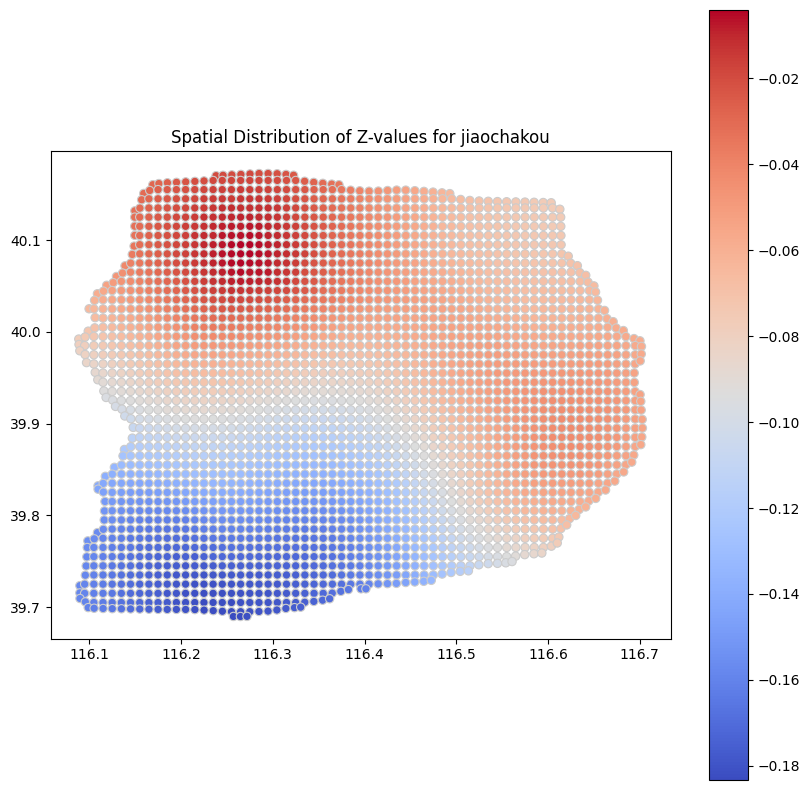

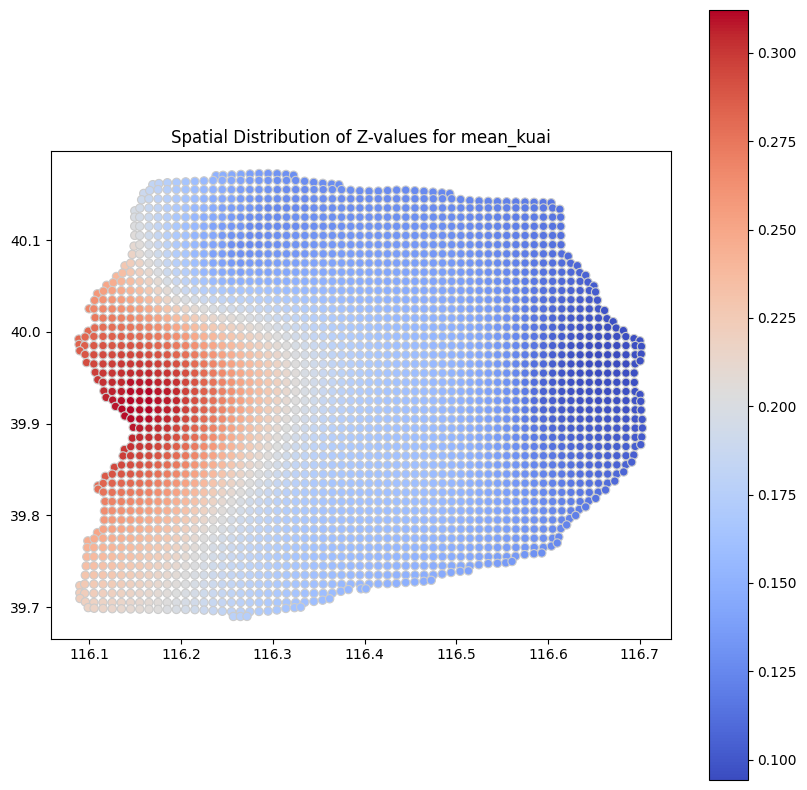

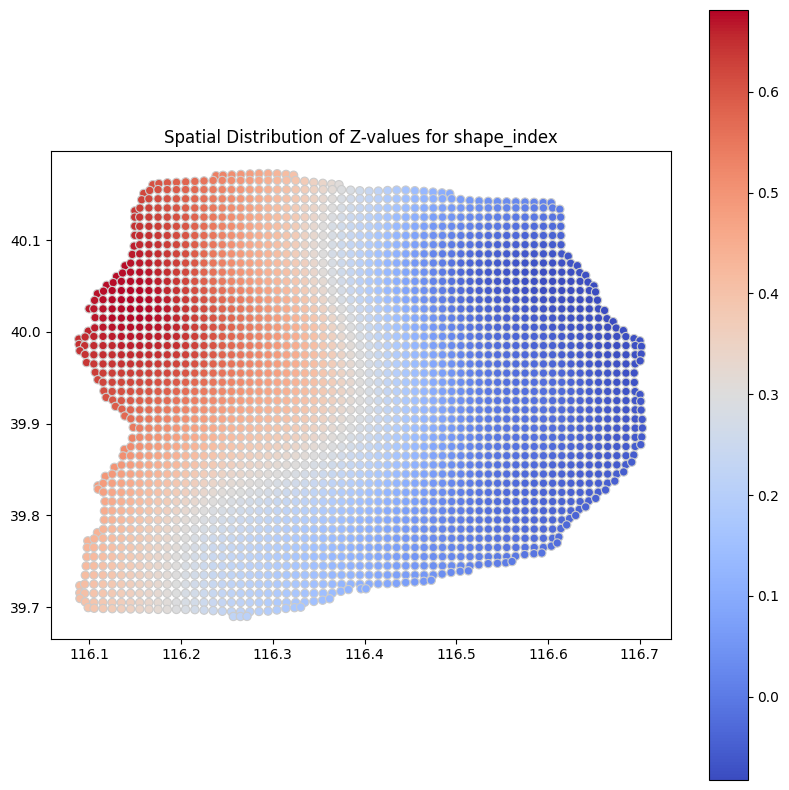

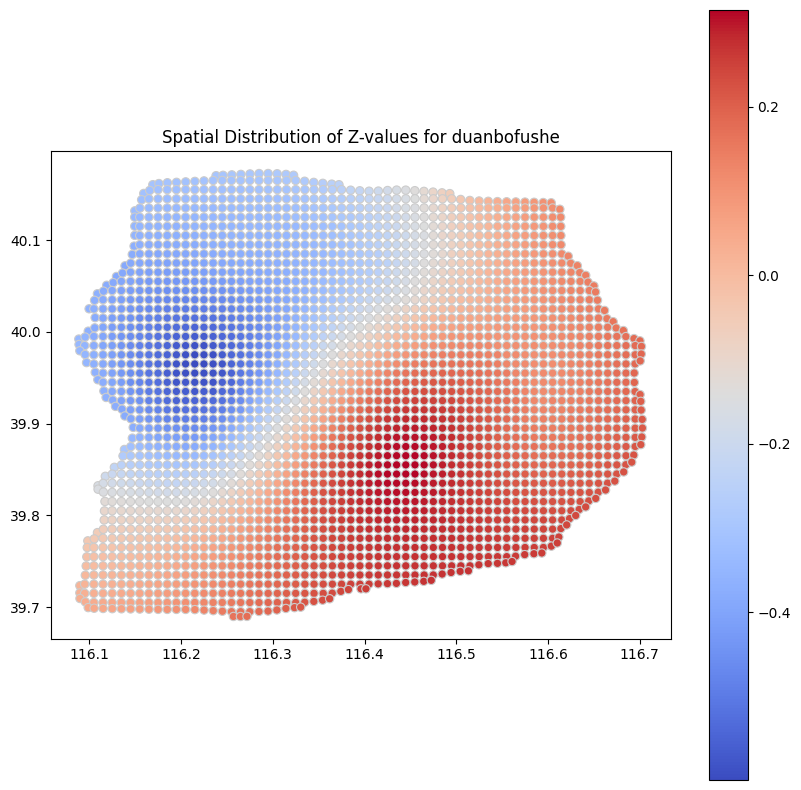

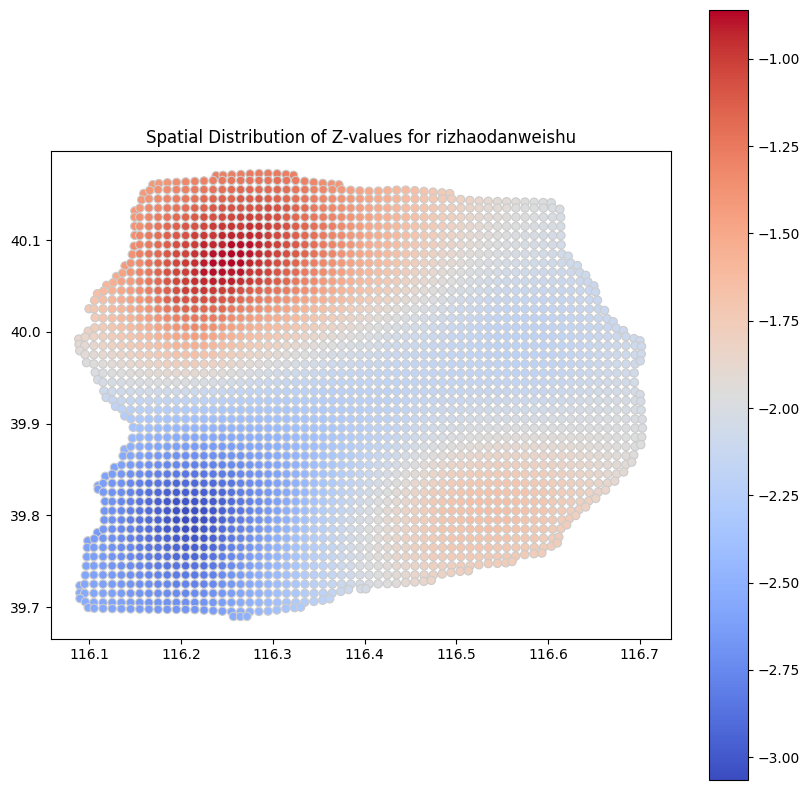

...

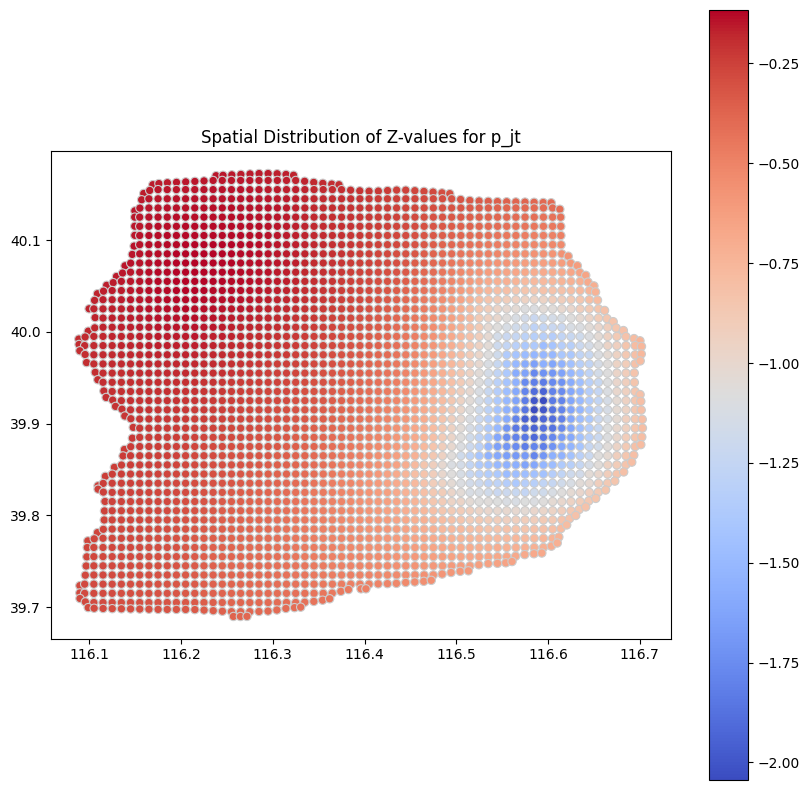

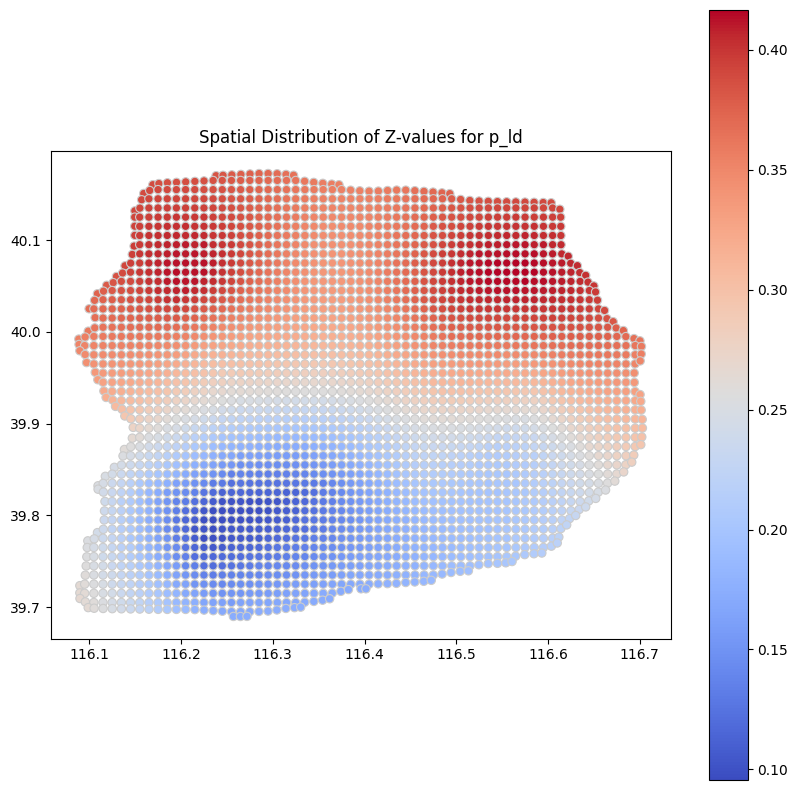

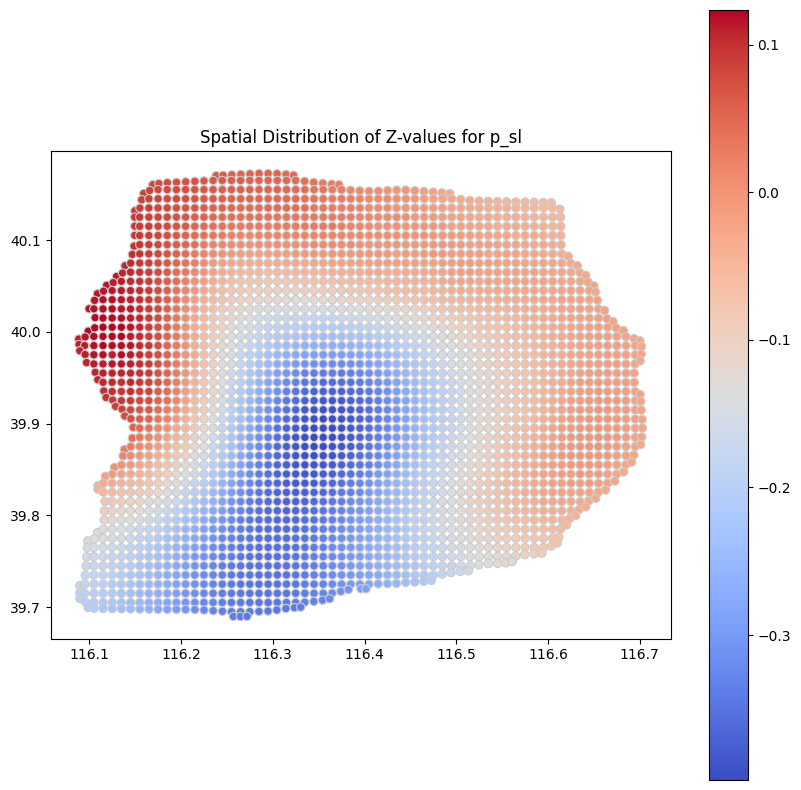

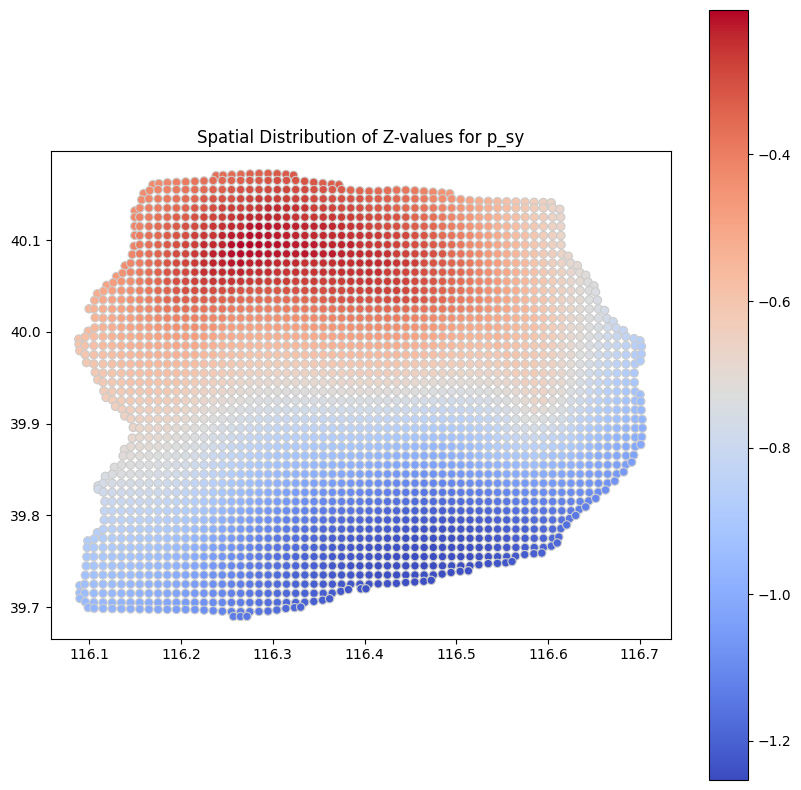

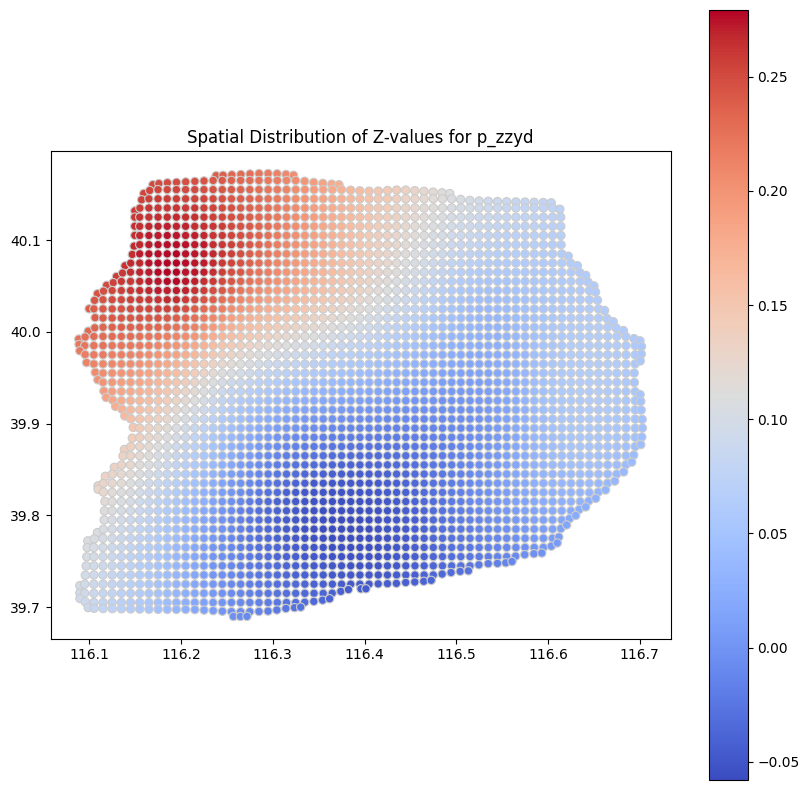

In [7]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import warnings
from scipy import stats
import geopandas as gpd
import matplotlib.pyplot as plt

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径并读取CSV文件
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\筛选综合.csv"
df = pd.read_csv(file_path)

# 提取因变量和自变量（基于指定的特征）
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

y = df[y_column].values.reshape((-1, 1))
coords = list(zip(df['X2'], df['Y']))
X = df[X_columns]

# 数据标准化及缺失值处理
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
mask = ~np.isnan(y.flatten())
y = y[mask]
X_scaled_df = pd.DataFrame(X_scaled[mask], columns=X_columns)
coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    # 带宽选择和GWR模型拟合
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()

    # 获取回归系数及其标准误差，并转换为DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': gwr_model.params.mean(axis=0)[1:],
        'StdError': gwr_model.bse.mean(axis=0)[1:]
    })

    # 计算Z值和p值
    coefficients['Z'] = coefficients['Coefficient'] / coefficients['StdError']
    coefficients['P-value'] = 2 * (1 - stats.norm.cdf(abs(coefficients['Z'])))

    # 筛选出p值小于0.05的变量
    significant_vars = coefficients[coefficients['P-value'] < 0.05]['Variable'].tolist()
    print(f"\nSignificant variables with p-value < 0.05: {significant_vars}")

    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient', 'StdError', 'Z', 'P-value']]
    
    # 输出模型摘要信息
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")

    print("\nCoefficients:")
    print(coefficients)

    # 创建GeoDataFrame用于绘图
    gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['X2'], df['Y']))

    # 对每个显著变量的Z值进行空间可视化
    for var in significant_vars:
        z_values = gwr_model.params[:, X_columns.index(var)]
        gdf['z_value'] = z_values
        
        fig, ax = plt.subplots(figsize=(10, 10))
        gdf.plot(column='z_value', cmap='coolwarm', linewidth=0.8, edgecolor='0.8', ax=ax, legend=True)
        plt.title(f'Spatial Distribution of Z-values for {var}')
        plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")